<a href="https://colab.research.google.com/github/ylnrahma/PCVK_ganjil2023/blob/main/TUGASBESAR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Akses Google Drive
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


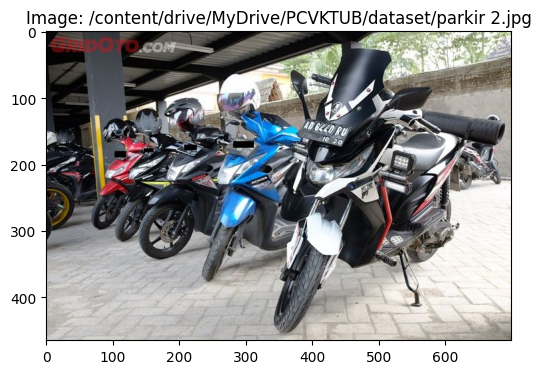

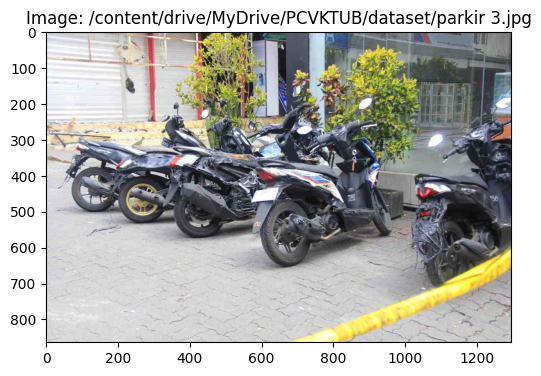

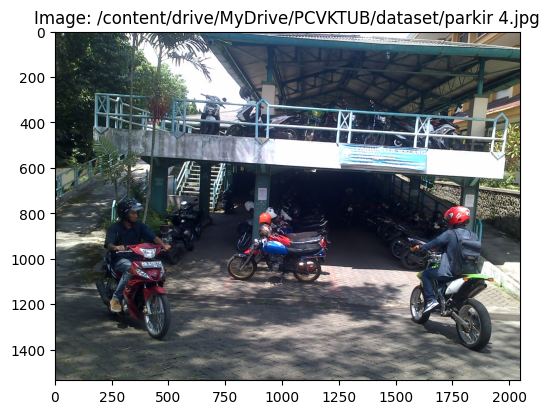

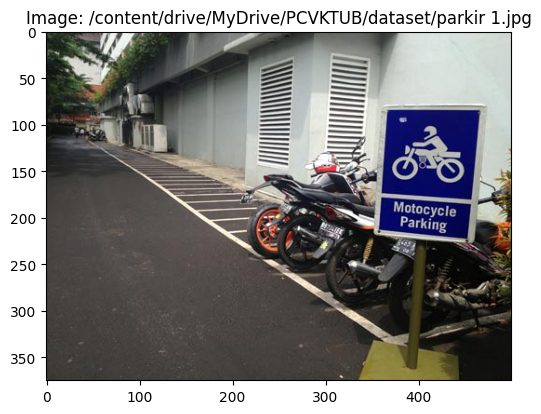

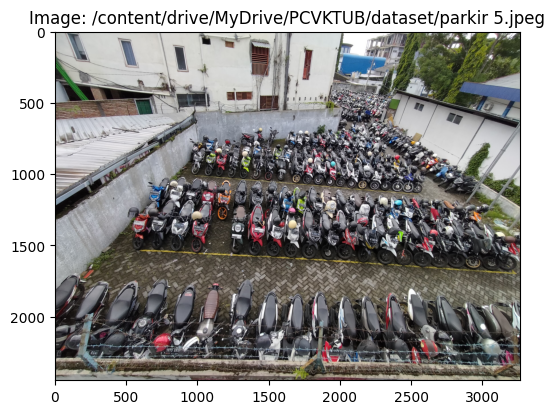

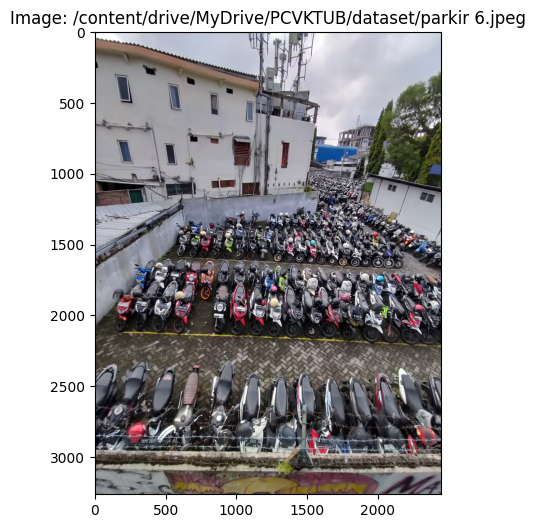

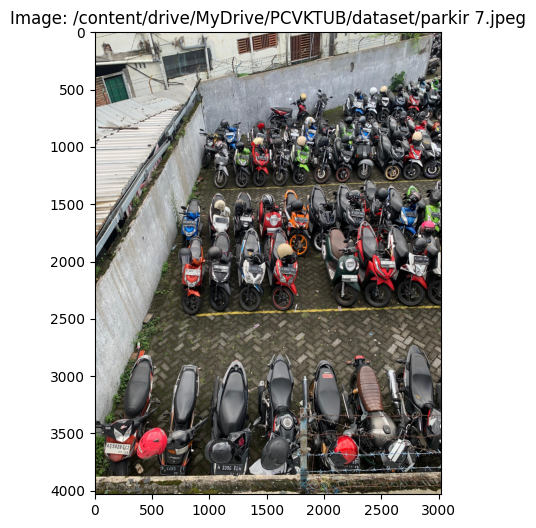

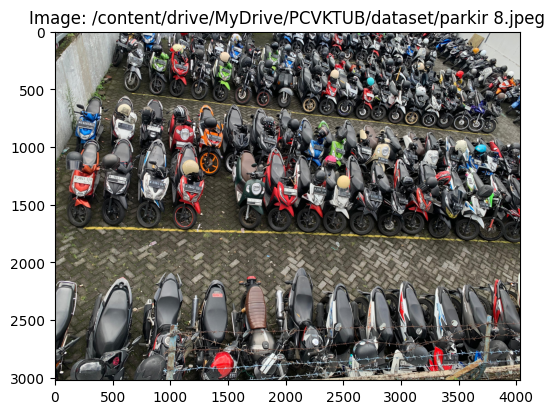

In [57]:
import cv2 as cv
import matplotlib.pyplot as plt
import glob

# Path ke direktori yang berisi gambar dengan ekstensi .jpg
image_folder_path = '/content/drive/MyDrive/PCVKTUB/dataset/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpeg
image_files = glob.glob(image_folder_path + '*.jpg')+ glob.glob(image_folder_path + '*.jpeg')

# Loop melalui setiap file gambar dan menampilkannya
for image_path in image_files:
    # Baca gambar menggunakan OpenCV
    original_image = cv.imread(image_path)

    # Periksa apakah pembacaan gambar berhasil
    if original_image is None:
        print(f"Gambar {image_path} tidak dapat dibaca.")
    else:
        # Tampilkan gambar menggunakan matplotlib
        fig, ax = plt.subplots(figsize=(6, 6))
        ax.imshow(cv.cvtColor(original_image, cv.COLOR_BGR2RGB))
        ax.set_title(f"Image: {image_path}")
        plt.show()


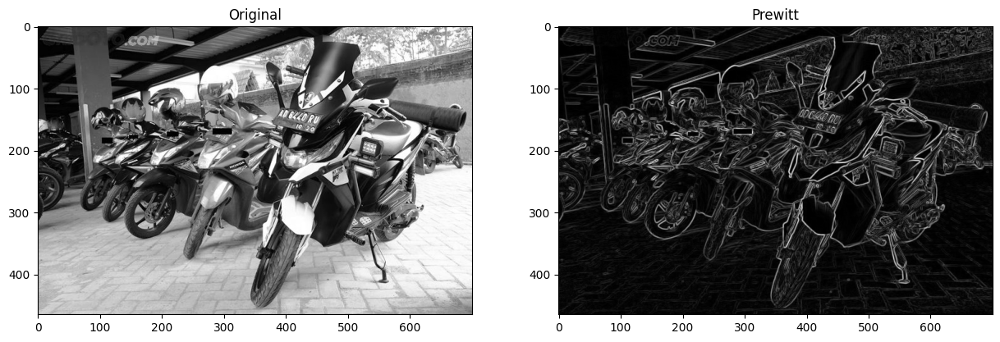

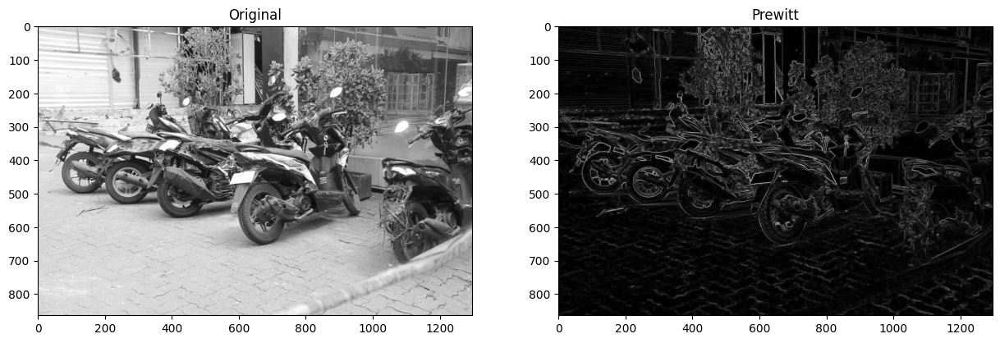

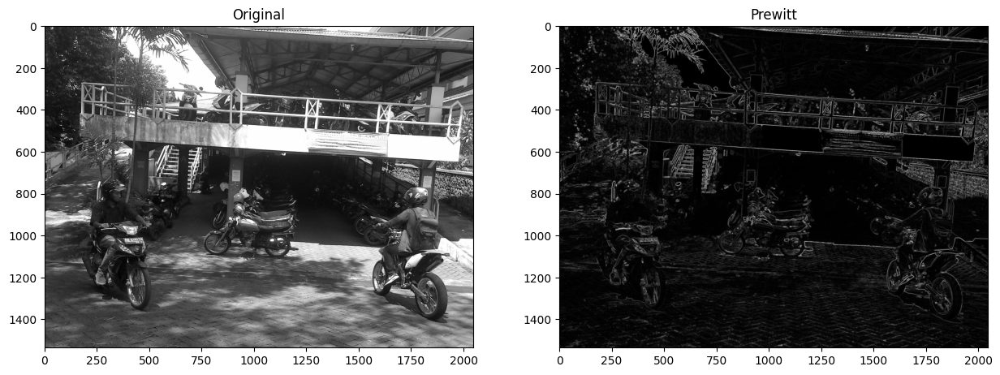

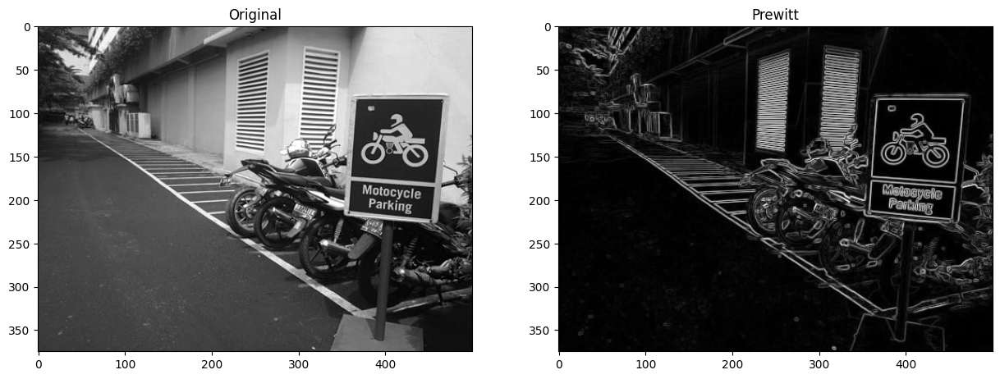

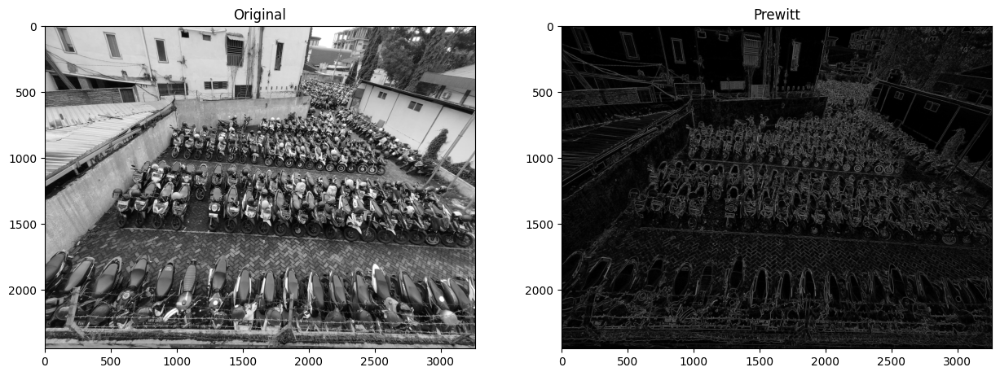

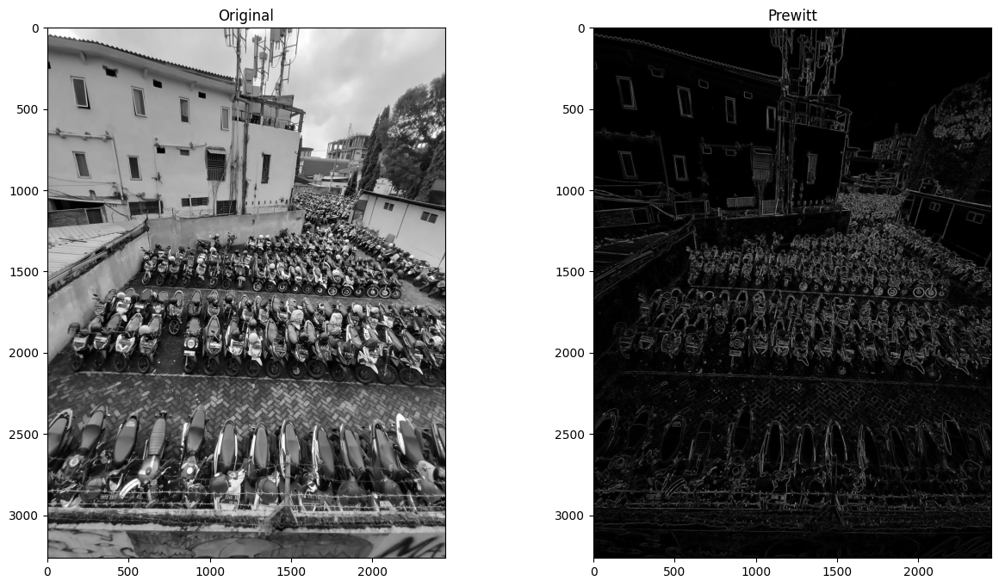

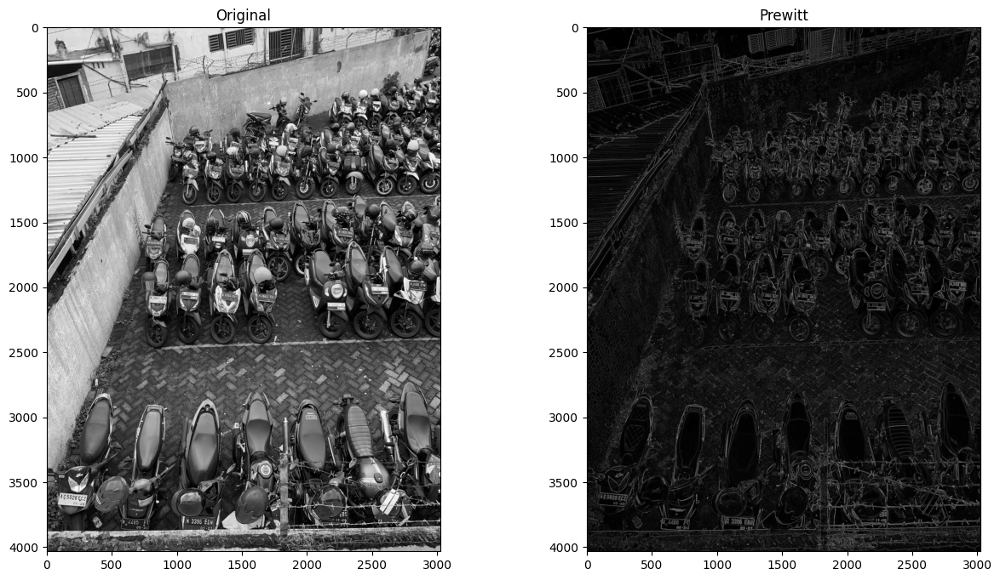

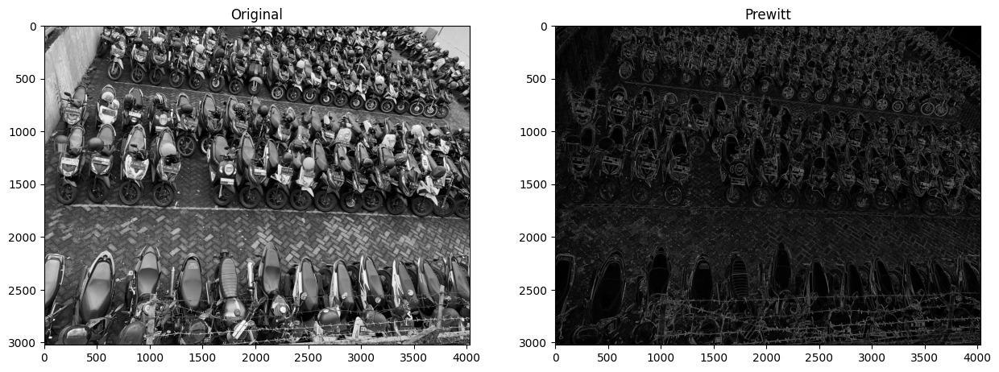

In [56]:
from skimage import io, filters
import matplotlib.pyplot as plt
import cv2
import glob

# Path ke direktori yang berisi gambar dengan ekstensi .jpg
image_folder_path = '/content/drive/MyDrive/PCVKTUB/dataset/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpg atau .jpeg
image_files = glob.glob(image_folder_path + '*.jpg') + glob.glob(image_folder_path + '*.jpeg')

# Loop melalui setiap file gambar dan menampilkannya
for image_path in image_files:
    # Baca gambar menggunakan skimage
    img = io.imread(image_path)

    # Ubah gambar menjadi grayscale menggunakan OpenCV
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Lakukan operasi Prewitt menggunakan skimage
    imgP = filters.prewitt(img_gray)

    # Tampilkan gambar menggunakan matplotlib
    fig, ax = plt.subplots(1, 2, figsize=(15, 8))
    ax[0].imshow(img_gray, cmap='gray')
    ax[1].imshow(imgP, cmap='gray')

    ax[0].set_title("Original")
    ax[1].set_title("Prewitt")

    plt.show()


--2023-12-05 01:29:26--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights.9’

yolov3.weights.9    100%[===================>] 236.52M  23.2MB/s    in 7.2s    

2023-12-05 01:29:34 (32.9 MB/s) - ‘yolov3.weights.9’ saved [248007048/248007048]

--2023-12-05 01:29:34--  https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8342 (8.1K) [text/plain]
Saving to: ‘yolov3.cfg.9’

yolov3.cfg.9        100%[===================>]   8.15K  --.-KB/s    in 0.0

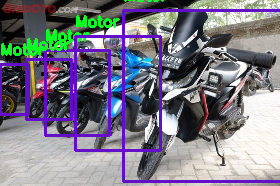

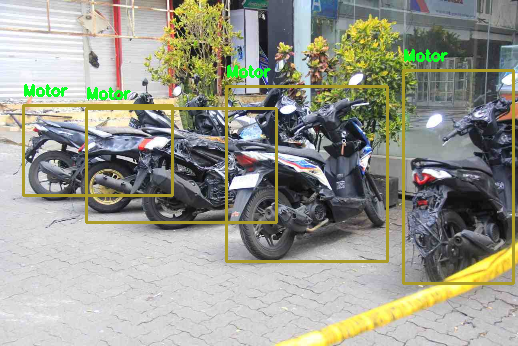

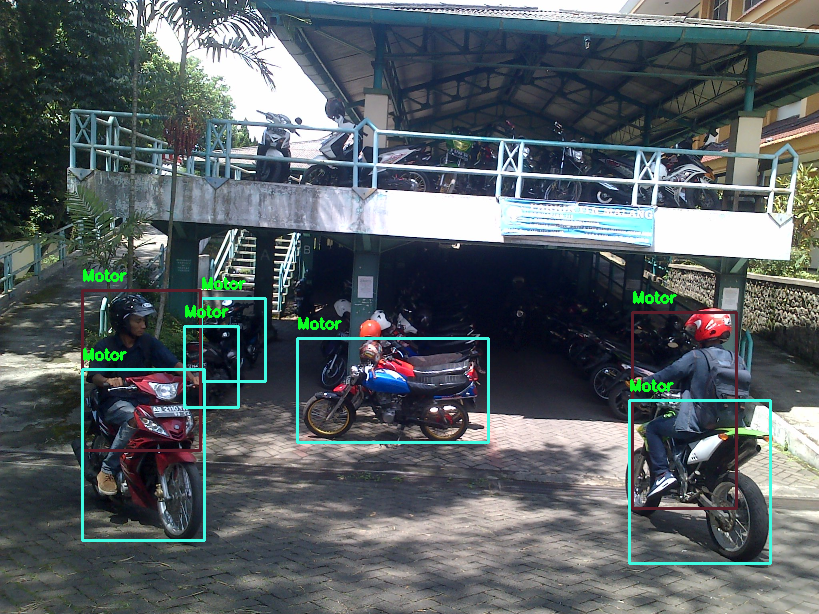

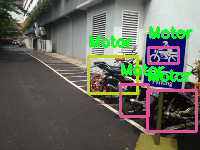

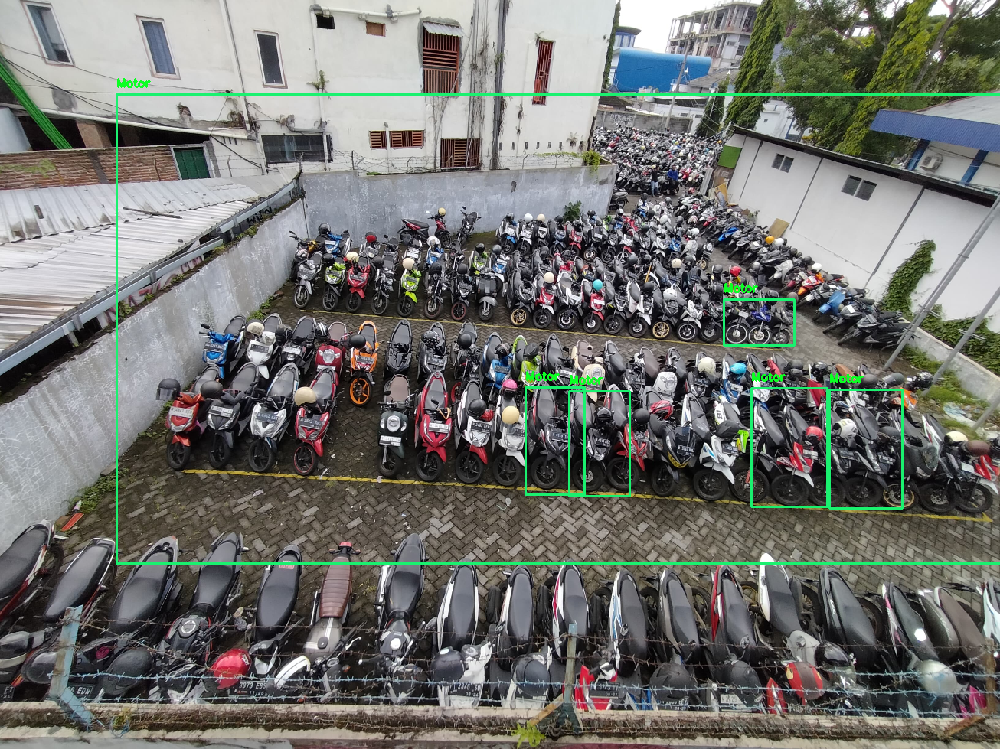

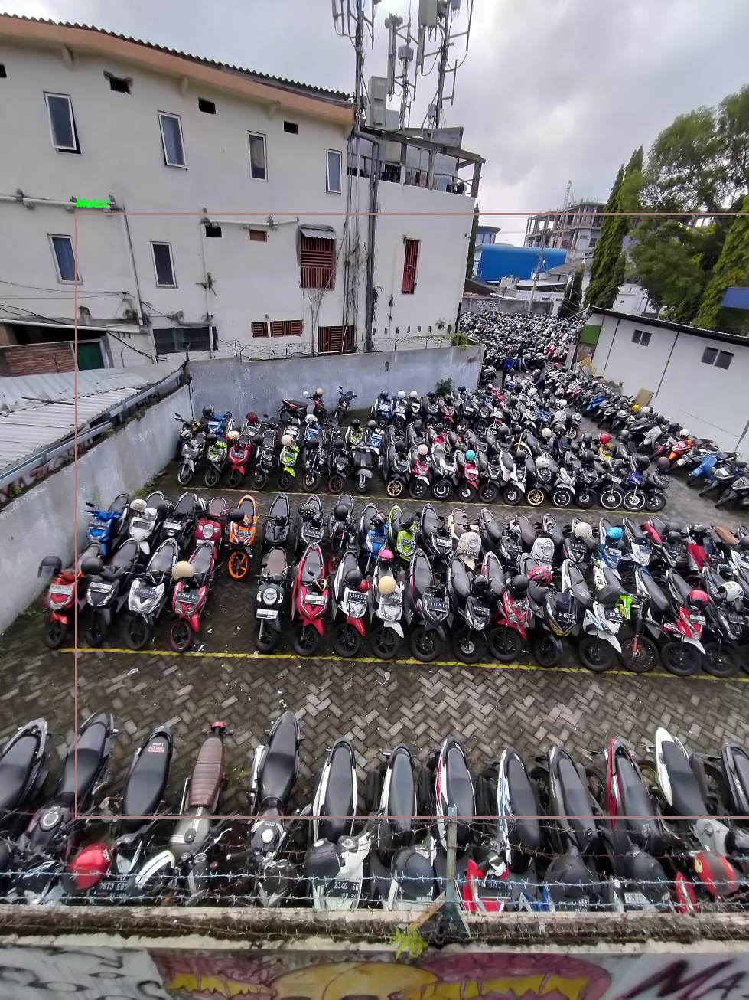

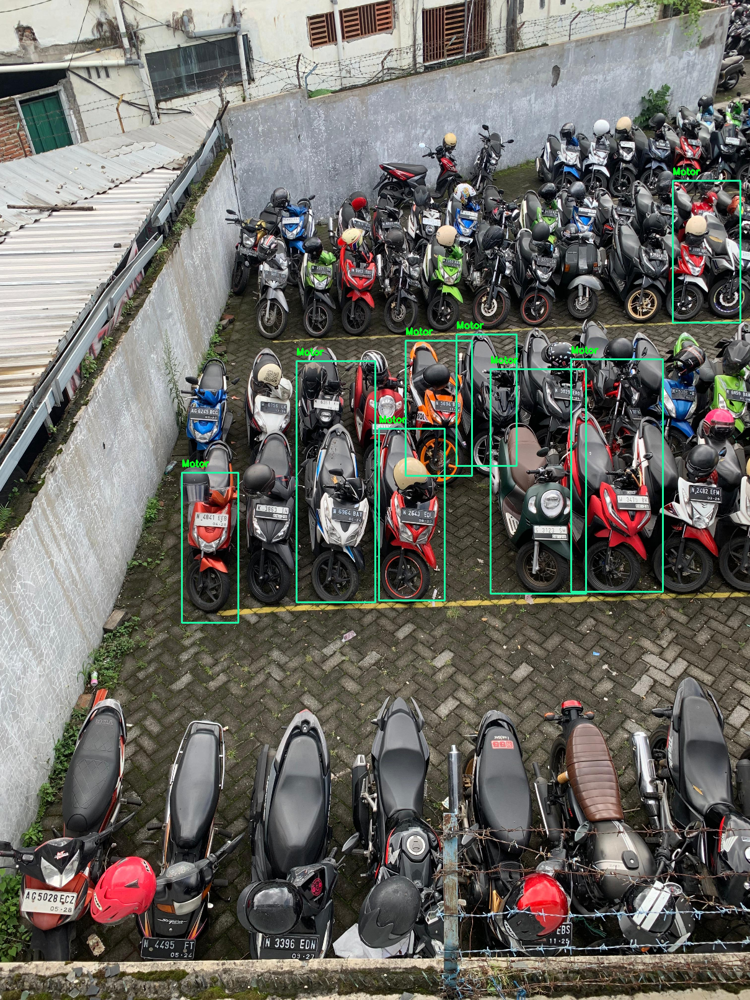

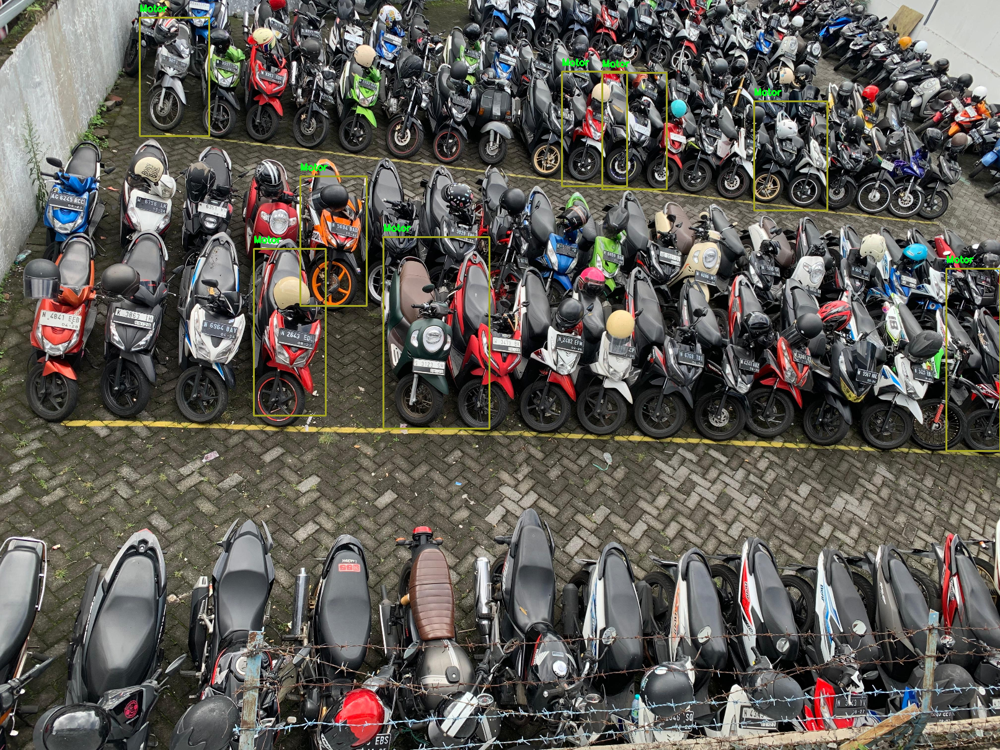

In [58]:
import numpy as np
import cv2
import glob
from google.colab.patches import cv2_imshow

!wget "https://pjreddie.com/media/files/yolov3.weights"
!wget "https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg"
!wget "https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names"

# Load YOLO
net = cv2.dnn.readNet("yolov3.weights", "yolov3.cfg")

# Get output layer names
layer_names = net.getLayerNames()
output_layers = [layer_names[i-1] for i in net.getUnconnectedOutLayers()]

# Path ke direktori yang berisi gambar dengan ekstensi .jpg
image_folder_path = '/content/drive/MyDrive/PCVKTUB/dataset/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpg
image_files = glob.glob(image_folder_path + '*.jpg') + glob.glob(image_folder_path + '*.jpeg')

# Loop melalui setiap file gambar dan deteksi objek menggunakan YOLOv3
for image_path in image_files:
    # Loading image
    img = cv2.imread(image_path)
    img = cv2.resize(img, None, fx=0.4, fy=0.4)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(output_layers)

    # Read class names from coco.names
    classes = []
    with open("coco.names", "r") as f:
        classes = [line.strip() for line in f.readlines()]

    # Generate random colors for different classes
    colors = np.random.uniform(0, 255, size=(len(classes), 3))

    # Collect detected objects
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                # Object detected
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)
                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

    font = cv2.FONT_HERSHEY_PLAIN
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            color = colors[class_ids[i]]
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)

            # Menambahkan label "Motor" kepada setiap objek yang berhasil dideteksi
            cv2.putText(img, 'Motor', (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (36, 255, 12), 2)

    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()


In [61]:
!git clone https://github.com/tensorflow/tpu/

Cloning into 'tpu'...
remote: Enumerating objects: 11630, done.
remote: Counting objects: 100% (1832/1832), done.
remote: Compressing objects: 100% (822/822), done.
remote: Total 11630 (delta 1059), reused 1619 (delta 964), pack-reused 9798
Receiving objects: 100% (11630/11630), 47.06 MiB | 16.28 MiB/s, done.
Resolving deltas: 100% (8097/8097), done.


In [63]:
from IPython import display
from PIL import Image
import numpy as np
import tensorflow as tf
import sys
sys.path.insert(0, 'tpu/models/official')
sys.path.insert(0, 'tpu/models/official/mask_rcnn')
import coco_metric
from mask_rcnn.object_detection import visualization_utils

In [64]:
ID_MAPPING = {
    1: 'person',
    2: 'motorcycle',
}
category_index = {k: {'id': k, 'name': ID_MAPPING[k]} for k in ID_MAPPING}

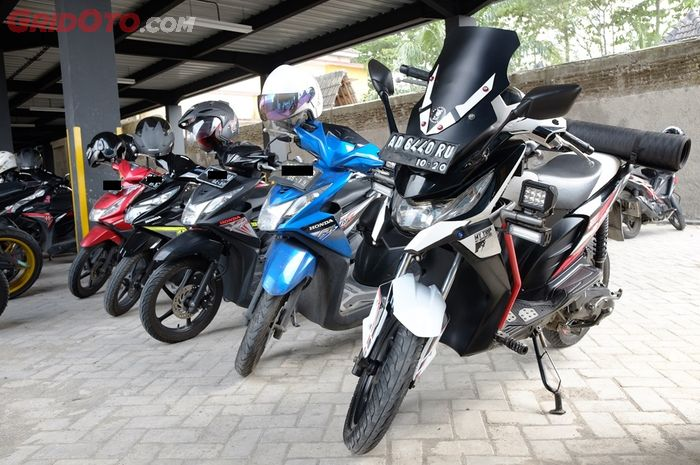

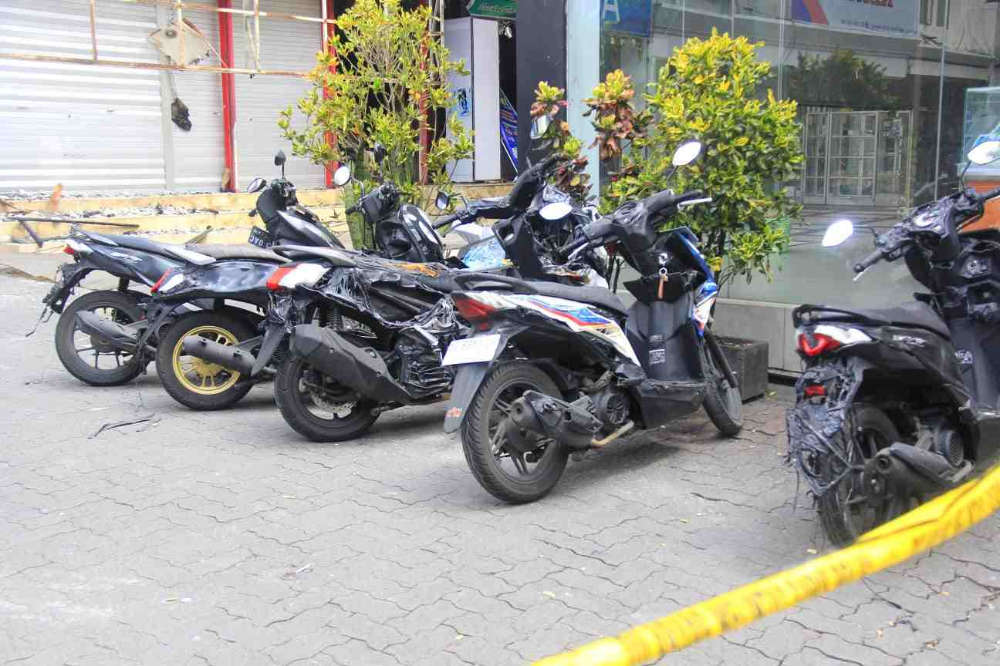

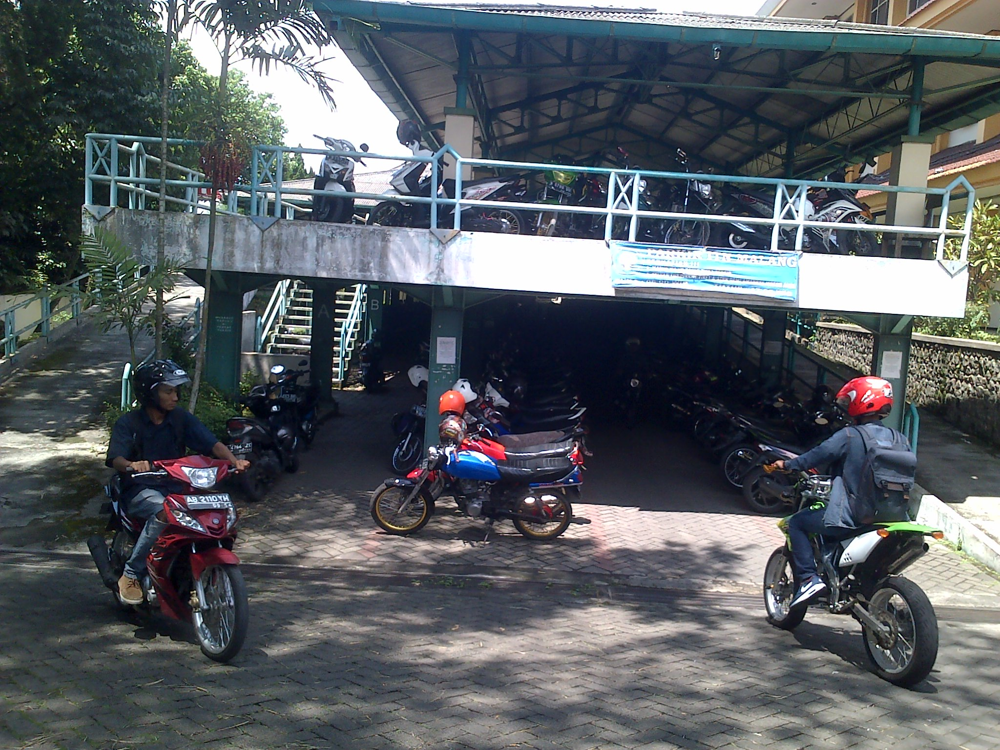

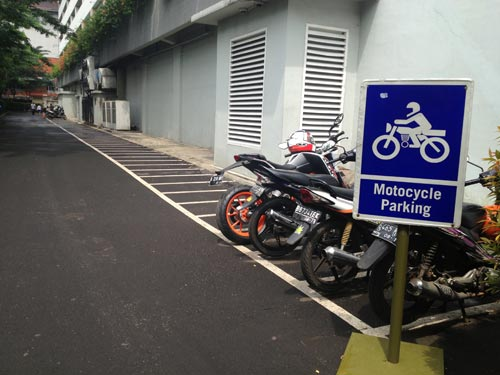

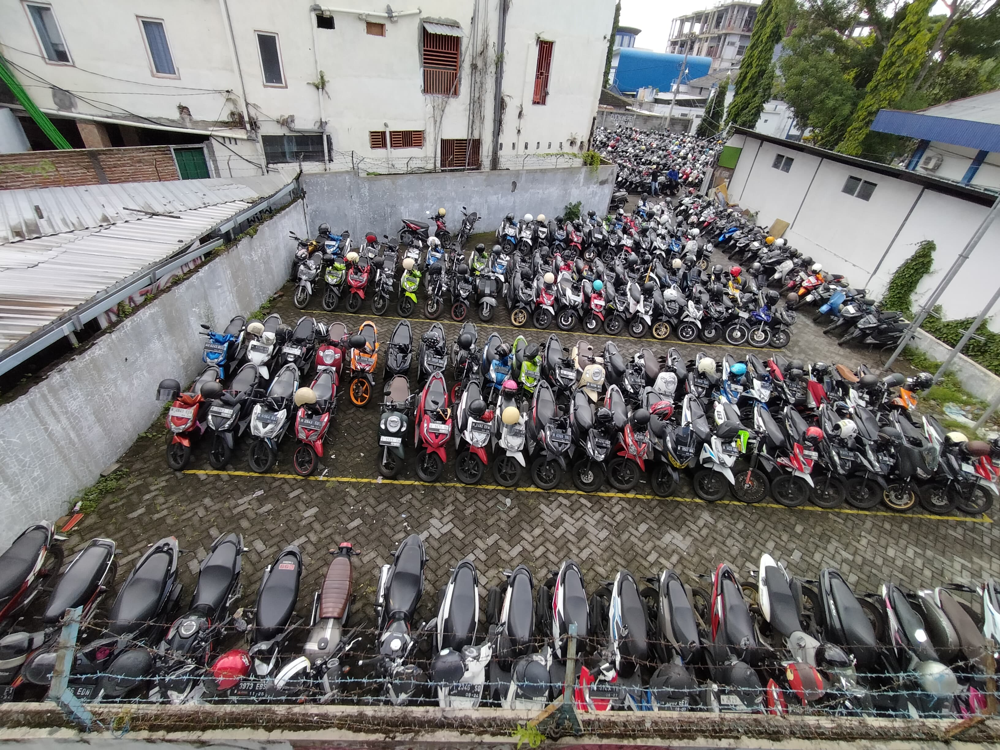

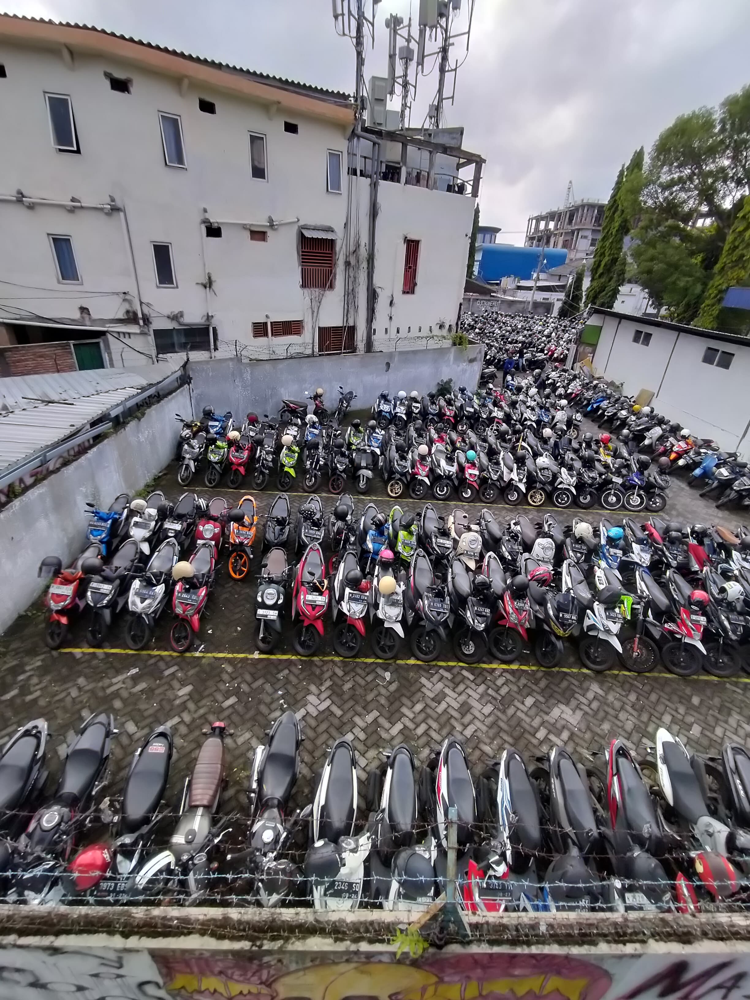

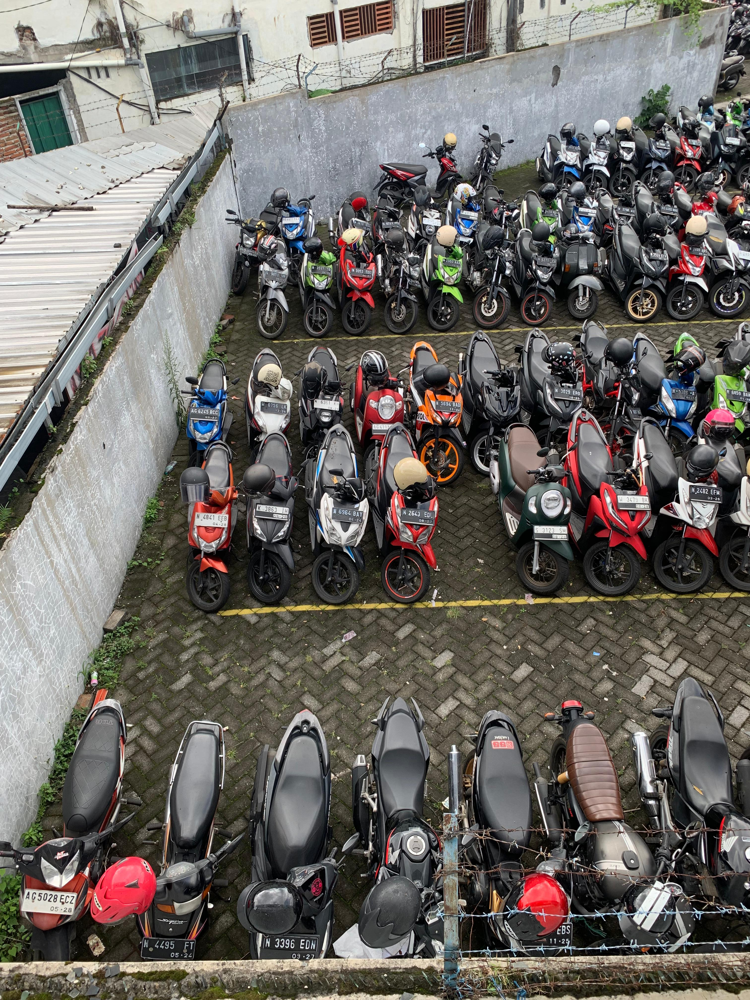

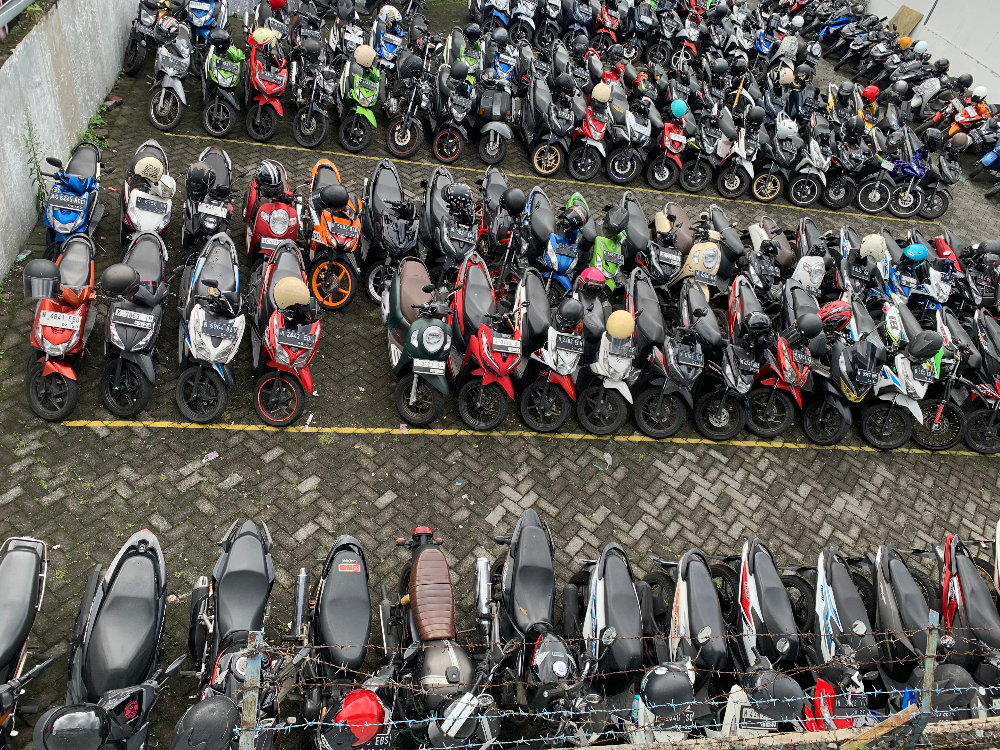

In [70]:
import glob
from PIL import Image
import IPython.display as display
import tensorflow as tf

# Path ke direktori yang berisi gambar dengan ekstensi .jpg
image_folder_path = '/content/drive/MyDrive/PCVKTUB/dataset/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpg atau .jpeg
image_files = glob.glob(image_folder_path + '*.jpg') + glob.glob(image_folder_path + '*.jpeg')

# Loop melalui setiap file gambar dan menampilkannya
for image_path in image_files:
    # Baca gambar
    image = Image.open(image_path)

    # Menampilkan gambar
    display.display(display.Image(image_path, width=1024))
